<a href="https://www.kaggle.com/code/tanavbajaj/hospital-comments-eda?scriptVersionId=136177592" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# Data Analysis on Diabetes Private Hospital Datasets

In [1]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import re
import pandas as pd
import spacy
import en_core_web_sm
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer


In [2]:
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('wordnet')
nltk.download('wordnet2022')

! cp -rf /usr/share/nltk_data/corpora/wordnet2022 /usr/share/nltk_data/corpora/wordnet # temp fix for lookup error.

[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /usr/share/nltk_data...
[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package wordnet2022 to /usr/share/nltk_data...
[nltk_data]   Unzipping corpora/wordnet2022.zip.


In [3]:
df = pd.read_csv("/kaggle/input/private-hospital-comments/comments1.csv")

In [4]:
df["Main Topic"] = df["Main Topic"].fillna("No Topic Given")
df = df.dropna(subset=["Content"])
nan_counts = df.isna().sum()

print(nan_counts)

Comment ID            0
Main Topic            0
Subtopic              0
Content               0
Province            420
Age                 435
Gender              425
Public Role        1573
Non-public role    4126
dtype: int64


# Function for Data Preprocessing (Lemmatization and stop word removal)

In [5]:
# Defining regex patterns.
linebreaks        = "<br /><br />"
alphaPattern      = "[^a-z0-9<>]"
sequencePattern   = r"(.)\1\1+"
seqReplacePattern = r"\1\1"

# Defining regex for emojis
smileemoji        = r"[8:=;]['`\-]?[)d]+"
sademoji          = r"[8:=;]['`\-]?\(+"
neutralemoji      = r"[8:=;]['`\-]?[\/|l*]"
lolemoji          = r"[8:=;]['`\-]?p+"

stop_words = set(stopwords.words('english'))
Lemmatizer = WordNetLemmatizer()

In [6]:
def preprocess_reviews(review):

    review = review.lower()

    review = re.sub(linebreaks," ",review)
    # Replace 3 or more consecutive letters by 2 letter.
    review = re.sub(sequencePattern, seqReplacePattern, review)

    # Replace all emojis.
    review = re.sub(r'<3', '<heart>', review)
    review = re.sub(smileemoji, '<smile>', review)
    review = re.sub(sademoji, '<sadface>', review)
    review = re.sub(neutralemoji, '<neutralface>', review)
    review = re.sub(lolemoji, '<lolface>', review)

    # Remove non-alphanumeric and symbols
    review = re.sub(alphaPattern, ' ', review)
    
    # Tokenize the input text
    tokens = word_tokenize(review)
    
    # Remove stop words from the token sequence

    tokens = [token for token in tokens if token not in stop_words]
    
    # Lemmatize the remaining tokens
    tokens = [Lemmatizer.lemmatize(token) for token in tokens]
    
    # Join the cleaned tokens into a single string
    return ' '.join(tokens)
    

In [7]:
df['Main Topic'] = df['Main Topic'].apply(preprocess_reviews)
df['Subtopic'] = df['Subtopic'].apply(preprocess_reviews)
df['Content'] = df['Content'].apply(preprocess_reviews)

In [8]:
grouped = df.groupby(["Main Topic", "Subtopic"])
num_groups = grouped.ngroups
print(num_groups)

37


In [9]:
df["Subtopic + Content"] = df["Subtopic"] + " " + df["Content"]

In [10]:
# group the new DataFrame by "Main Topic" and create word clouds for each group
grouped2 = df.groupby(["Main Topic"])
num_groups2 = grouped2.ngroups
print(num_groups2)

6


# Word Clouds

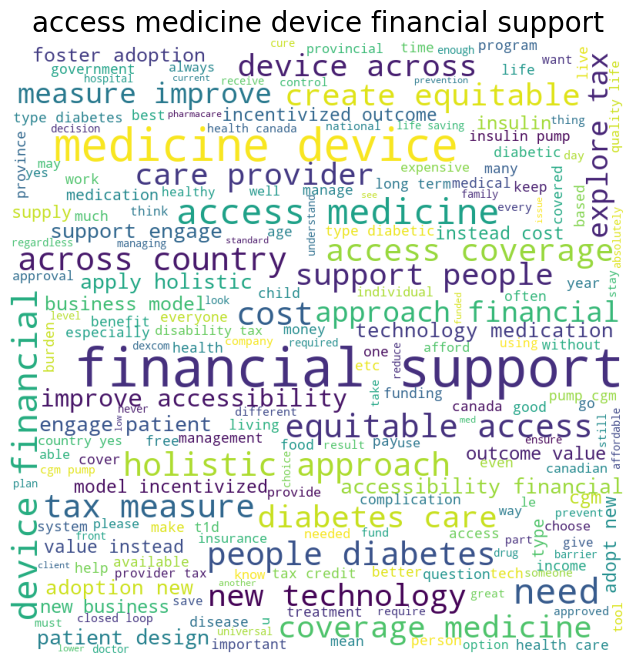

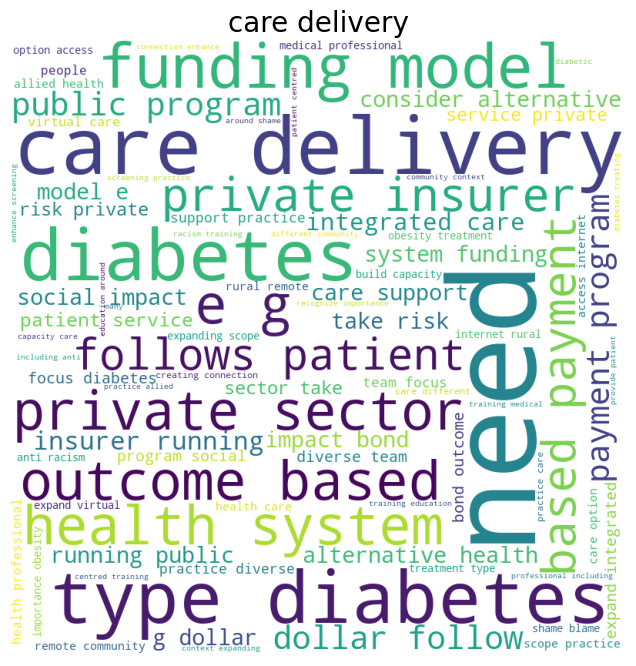

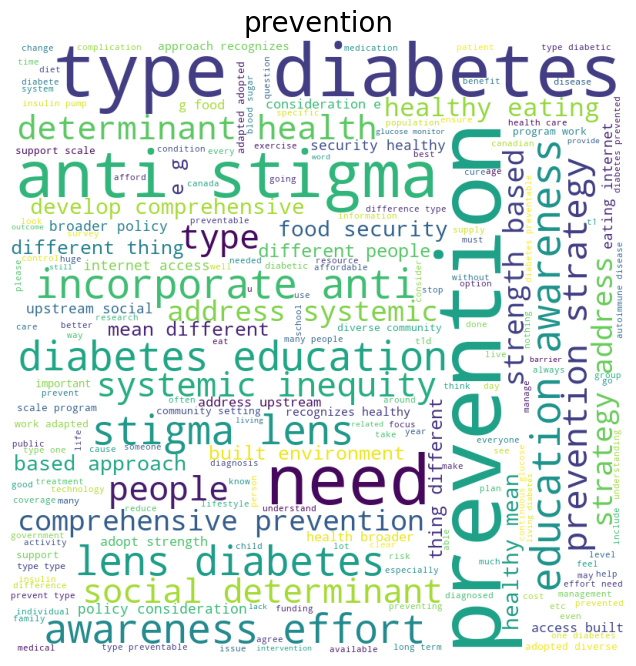

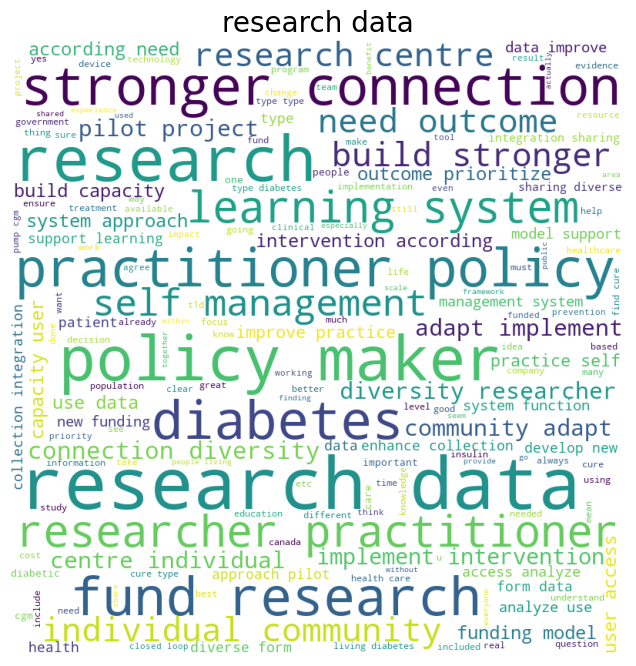

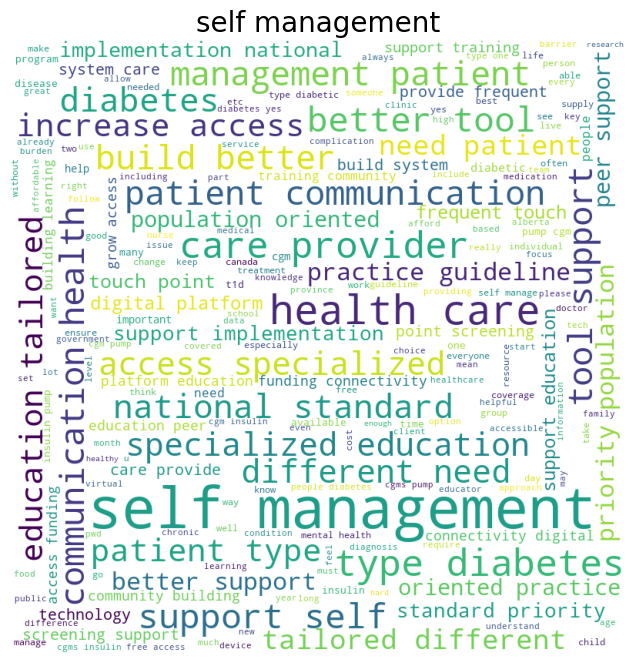

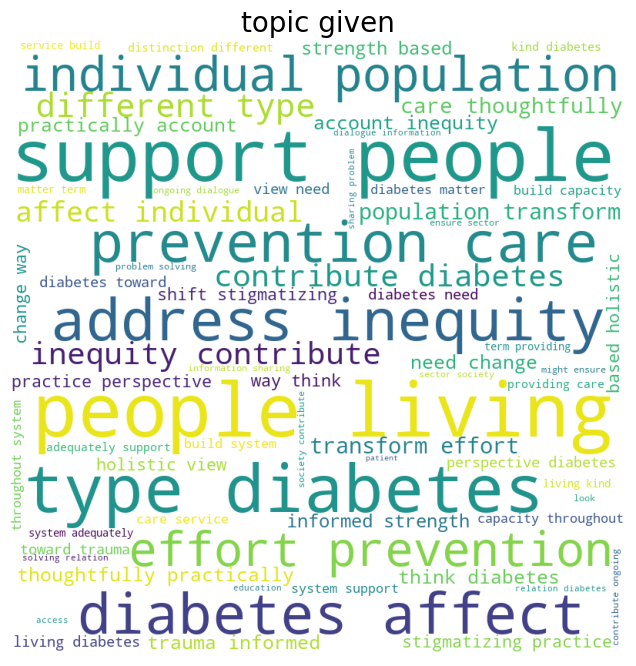

In [11]:
for group_name, group_data in grouped2:
    # combine all content strings into one string
    content_text = " ".join(group_data["Subtopic + Content"])
    # create a word cloud for the combined content
    wordcloud = WordCloud(width=800, height=800, background_color='white', 
                          min_font_size=10).generate(content_text)
    # plot the word cloud with the group name as the title
    plt.figure(figsize=(8,8))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(group_name, fontsize=20)
    plt.show()


In [12]:
group_sizes2 = grouped2.size()
print(group_sizes2)

Main Topic
access medicine device financial support     793
care delivery                               1062
prevention                                  1187
research data                                444
self management                              662
topic given                                 1261
dtype: int64


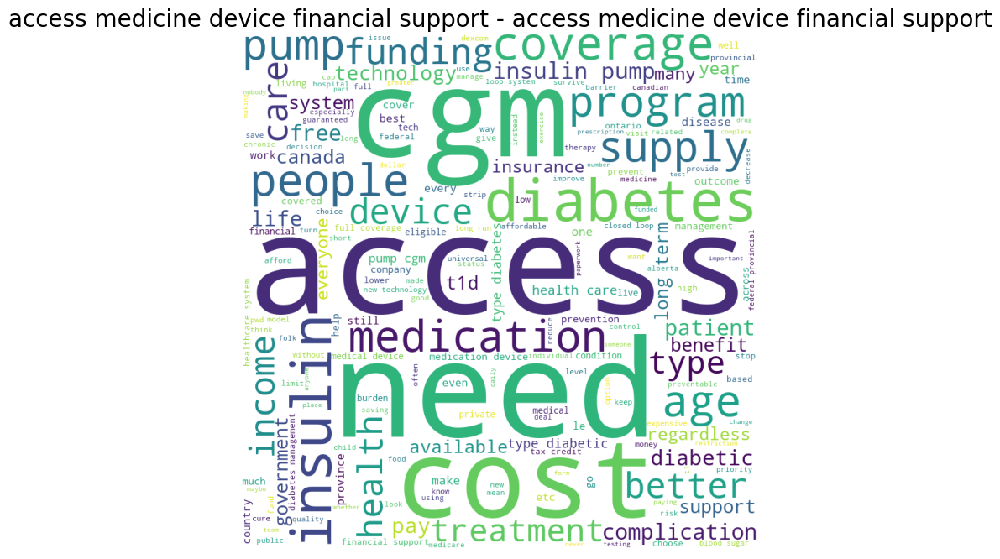

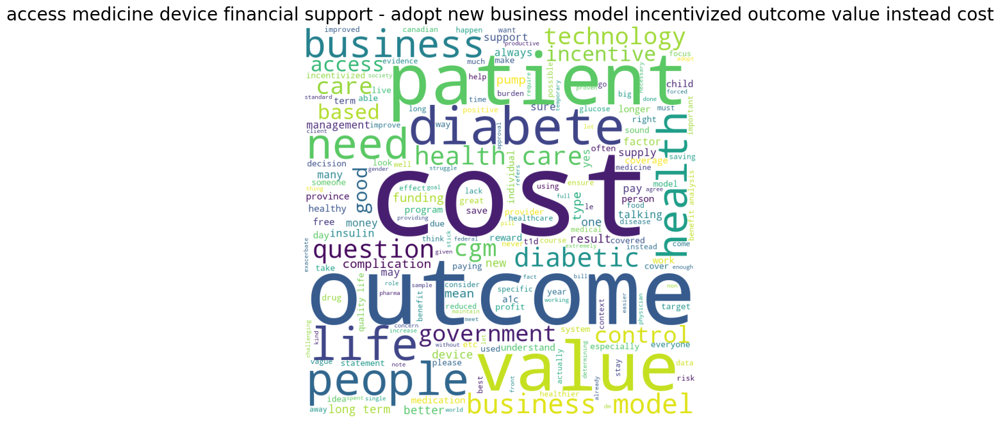

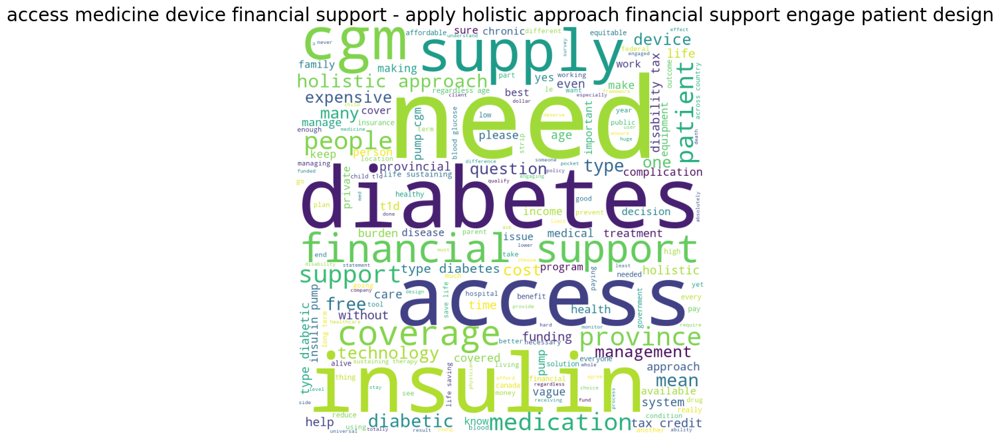

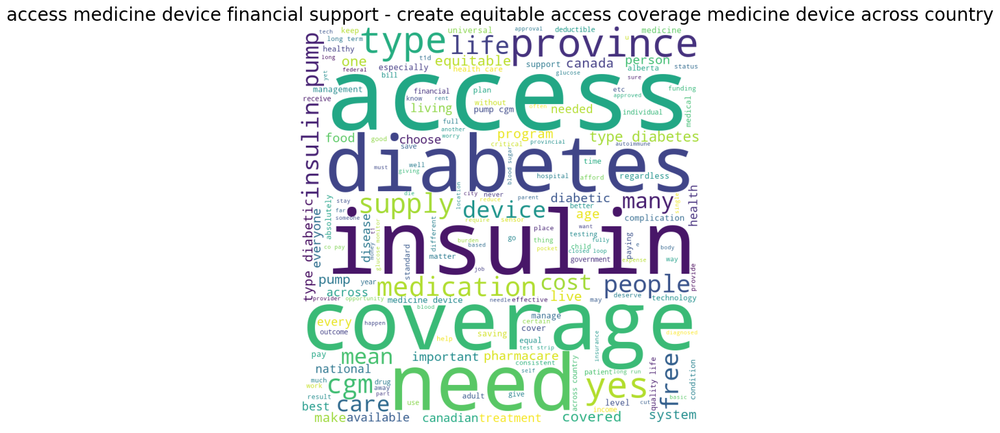

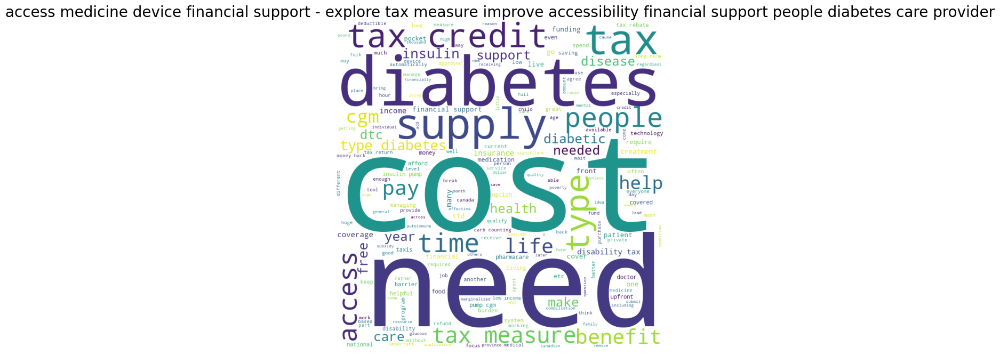

...

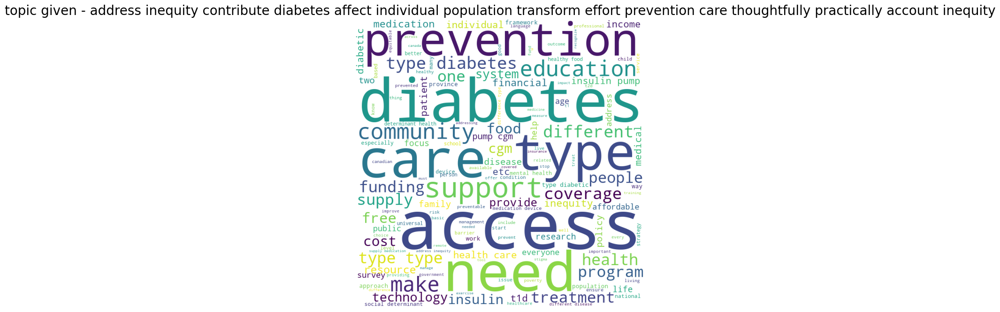

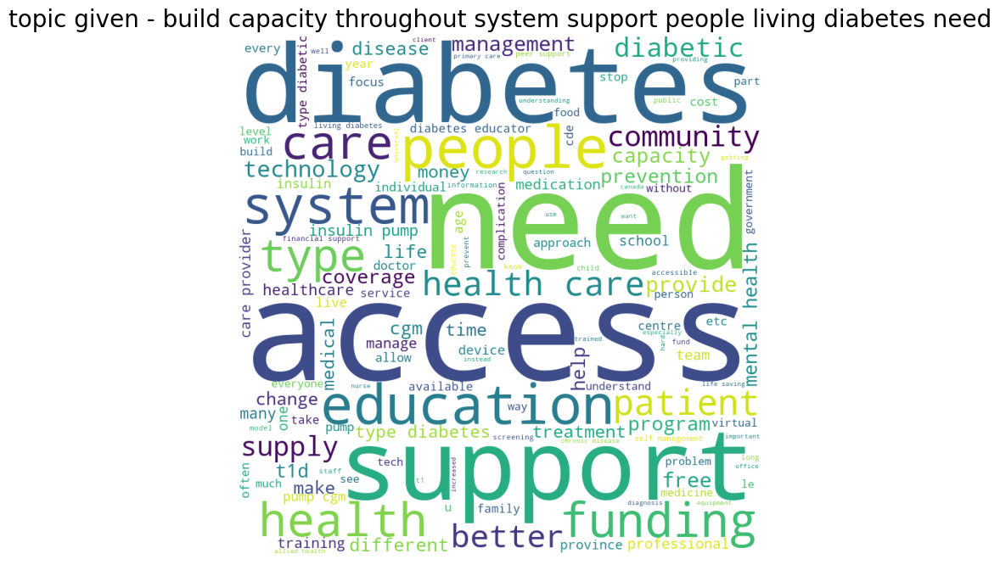

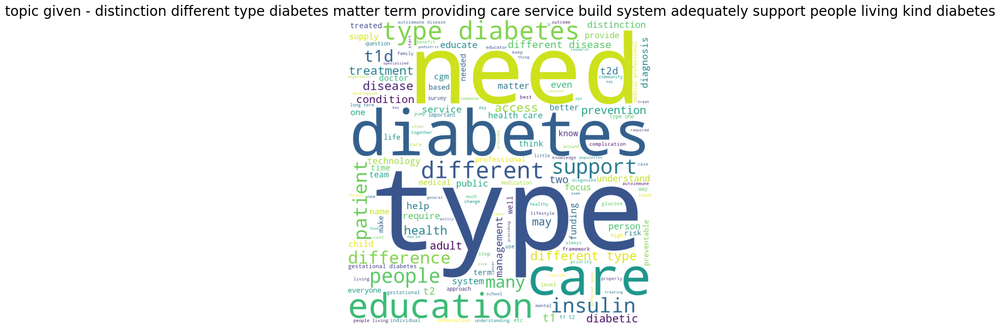

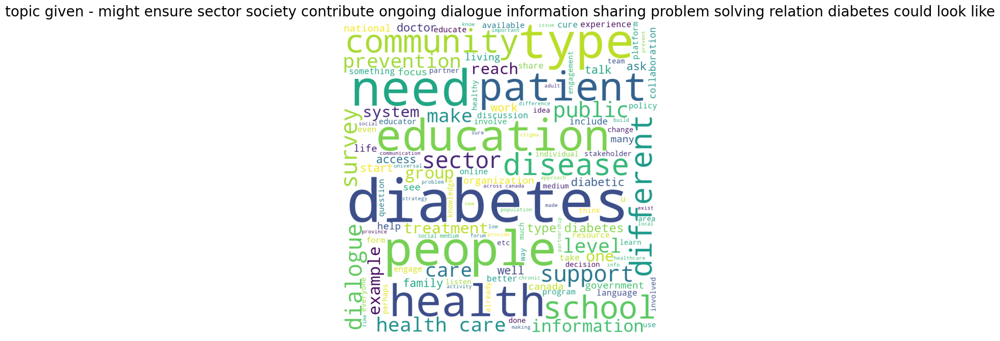

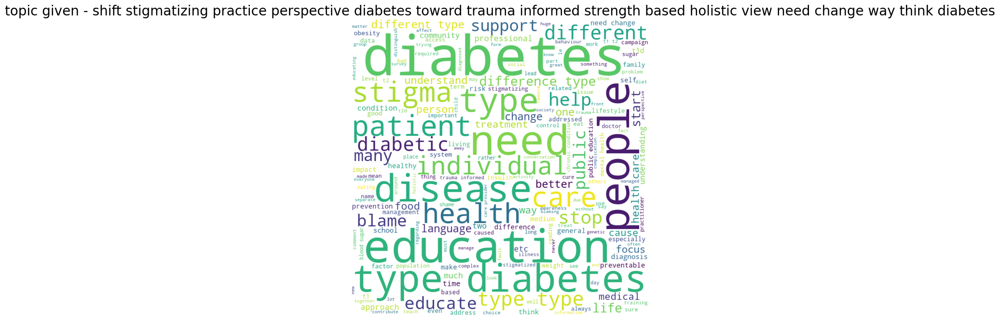

In [13]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
for group_name, group_data in grouped:
    # combine all content strings into one string
    content_text = " ".join(group_data["Content"])
    # create a word cloud for the combined content
    wordcloud = WordCloud(width=800, height=800, background_color='white', 
                          min_font_size=10).generate(content_text)
    # plot the word cloud with the group name as the title
    plt.figure(figsize=(8,8))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(group_name[0] + " - " + group_name[1], fontsize=20)
    plt.show()

In [14]:
# combine "Main Topic", "Subtopic", and "Content" columns into a single column called "Text"
df["Main Topic + Subtopic + Content"] = df["Main Topic"] + " " + df["Subtopic"] + " " + df["Content"]

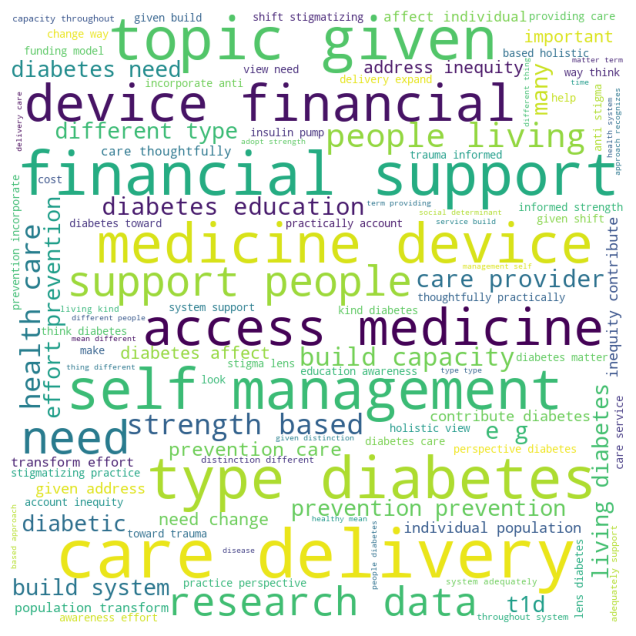

In [15]:
text = ' '.join(df['Main Topic + Subtopic + Content'].tolist())

wordcloud = WordCloud(width=800, height=800, background_color='white', min_font_size=10).generate(text)

plt.figure(figsize=(12, 8))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

# Vader Sentiment Analysis

In [16]:
import nltk
nltk.download("vader_lexicon")

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /usr/share/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

In [17]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer

analyzer = SentimentIntensityAnalyzer()

def vader_sentiment_result(sent):
    scores = analyzer.polarity_scores(sent)
    
    if scores["neg"] > scores["pos"]:
        return 0

    return 1

/opt/conda/lib/python3.7/site-packages/nltk/twitter/__init__.py:20: UserWarning: The twython library has not been installed. Some functionality from the twitter package will not be available.
  warnings.warn("The twython library has not been installed. "


In [18]:
df["Sentiment"]= df["Content"].apply(lambda x: vader_sentiment_result(x))

In [19]:
df["preprocessed"] = df["Main Topic"] + " " + df["Subtopic"] + " " + df["Content"]

In [20]:
df.head()

,Comment ID,Main Topic,Subtopic,Content,Province,Age,Gender,Public Role,Non-public role,Subtopic + Content,Main Topic + Subtopic + Content,Sentiment,preprocessed
0,131961,prevention,adopt strength based approach recognizes healt...,anyone get diabetes main message,BC,36 - 55,He/Him/His,y,NaN,adopt strength based approach recognizes healt...,prevention adopt strength based approach recog...,1,prevention adopt strength based approach recog...
1,131962,prevention,prevention,targeting age group,BC,36 - 55,He/Him/His,y,NaN,prevention targeting age group,prevention prevention targeting age group,1,prevention prevention targeting age group
2,131963,care delivery,expand integrated care support practice divers...,diabetes chronic illness treated doctor,BC,36 - 55,He/Him/His,y,NaN,expand integrated care support practice divers...,care delivery expand integrated care support p...,0,care delivery expand integrated care support p...
3,131964,care delivery,adopt strength based approach recognizes healt...,diabetic brittle insulin resistant etc,BC,36 - 55,He/Him/His,y,NaN,adopt strength based approach recognizes healt...,care delivery adopt strength based approach re...,1,care delivery adopt strength based approach re...
4,131965,care delivery,consider alternative health system funding mod...,regardless income level diabetes unaffordable ...,BC,36 - 55,He/Him/His,y,NaN,consider alternative health system funding mod...,care delivery consider alternative health syst...,0,care delivery consider alternative health syst...


In [21]:
   df_positive = df[df['Sentiment'] == 1]
   df_negative = df[df['Sentiment'] == 0]


In [22]:
   positive_text = ' '.join(df_positive['Content'])
   negative_text = ' '.join(df_negative['Content'])


In [23]:
   positive_wordcloud = WordCloud(width = 800, height = 800, 
                        background_color ='white').generate(positive_text) 

   negative_wordcloud = WordCloud(width = 800, height = 800, 
                        background_color ='white').generate(negative_text)


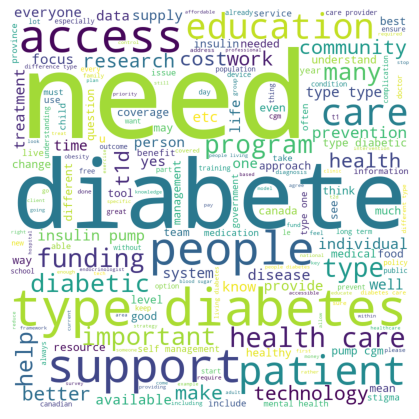

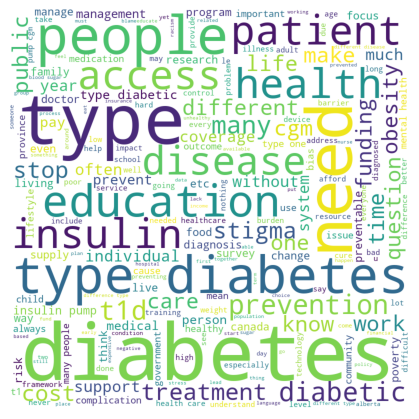

In [24]:
   plt.figure(figsize = (4, 4), facecolor = None) 
   plt.imshow(positive_wordcloud) 
   plt.axis("off") 
   plt.tight_layout(pad = 0) 
  
   plt.figure(figsize = (4, 4), facecolor = None) 
   plt.imshow(negative_wordcloud) 
   plt.axis("off") 
   plt.tight_layout(pad = 0) 
  
   plt.show()


# LDA Main Topics

In [25]:
tfidf = TfidfVectorizer(max_features=5000)
tfidf_matrix = tfidf.fit_transform(df['preprocessed'])


In [26]:
lda = LatentDirichletAllocation(n_components=2, random_state=0)
lda.fit(tfidf_matrix)


LatentDirichletAllocation(n_components=2, random_state=0)

In [27]:
for idx, topic in enumerate(lda.components_):
    print(f'Topic {idx}:')
    print([tfidf.get_feature_names()[i] for i in topic.argsort()[-10:]])
    print('\n')


Topic 0:
['need', 'program', 'health', 'practice', 'community', 'diabetes', 'data', 'research', 'delivery', 'care']


Topic 1:
['medicine', 'device', 'management', 'self', 'financial', 'access', 'diabetes', 'support', 'type', 'prevention']




/opt/conda/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [28]:
nlp = spacy.load("en_core_web_sm")

In [29]:
df['doc'] = df['preprocessed'].apply(nlp)
df['entities'] = df['doc'].apply(lambda x: [(ent.text, ent.label_) for ent in x.ents])


# Commentwise NER
- Output would have violated Privacy of dataset so code is commented out

In [30]:
# for idx, row in df.iterrows():
#     print(f'Comment {idx}: {row["Content"]}')
#     print(f'Entities: {row["entities"]}')
#     print('\n')


# Choropleth Map

In [31]:
import geopandas as gpd
geojson_file = '/kaggle/input/geojson-canada/canada.geojson'
map_data = gpd.read_file(geojson_file)

/opt/conda/lib/python3.7/site-packages/geopandas/_compat.py:115: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


* BC = colombie-britannique
* North = Territoires du Nord-Ouest
* ON/QC-eng = Québec
* Atlantic = Terre-Neuve-et-Labrador
* Prairies = Saskatchewan , Alberta ,  Manitoba

In [32]:
# Group the comments by province and count the number of comments in each province
province_counts = df.groupby("Province").size().reset_index(name="Count")


In [33]:
province_counts

,Province,Count
0,Atlantic,429
1,BC,949
2,NO DATA,116
3,North,103
4,ON/QC-eng,1962
5,Other,8
6,Prairies,1422


In [34]:
# Replace province names with Prairies
map_data['prov_name_fr'].replace({'Saskatchewan': 'Prairies', 'Alberta': 'Prairies', 'Manitoba': 'Prairies','Colombie-Britannique': 'BC' , 'Territoires du Nord-Ouest': 'North' ,'Québec' : 'ON/QC-eng' ,'Terre-Neuve-et-Labrador':  'Atlantic'   }, inplace=True)


In [35]:
unique_provinces = map_data['prov_name_fr'].unique()
print(unique_provinces)


['Prairies' 'Yukon' 'Nouvelle-Écosse' 'North' 'Île-du-Prince-Édouard'
 'Nunavut' 'ON/QC-eng' 'Ontario' 'BC' 'Atlantic' 'Nouveau-Brunswick']


In [36]:
# Merge the province counts to the map data
merged_data = map_data.merge(province_counts, left_on='prov_name_fr', right_on='Province')


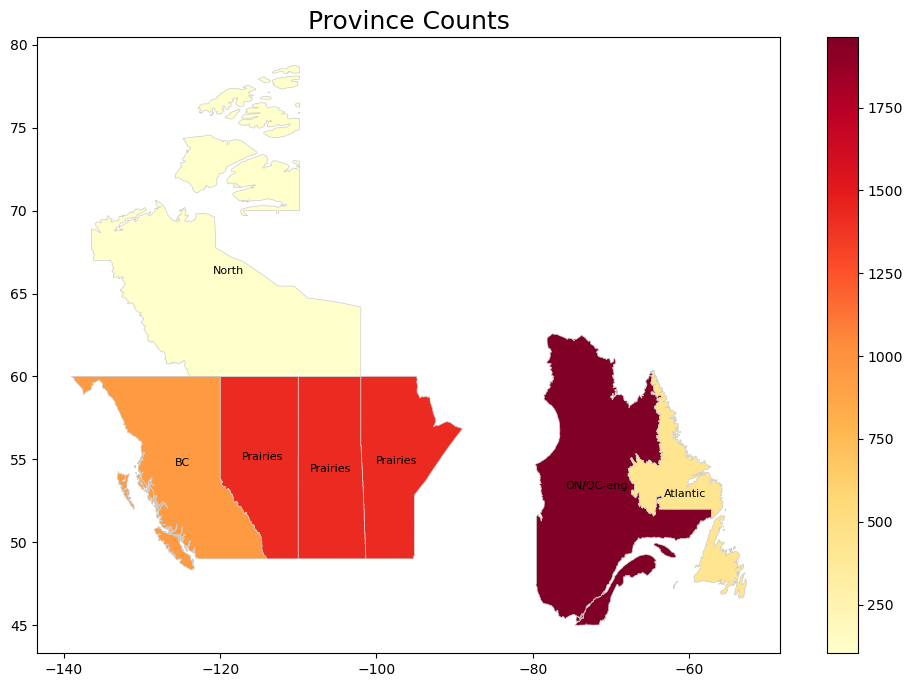

In [37]:
# Create the choropleth map
fig, ax = plt.subplots(figsize=(12,8))
merged_data.plot(column='Count', cmap='YlOrRd', linewidth=0.5, ax=ax, edgecolor='0.8', legend=True)

# Add province/territory names inside the territories
for idx, row in merged_data.iterrows():
    centroid = row.geometry.centroid
    ax.annotate(text=row['prov_name_fr'], xy=(centroid.x, centroid.y),
                horizontalalignment='center', verticalalignment='center',
                fontsize=8, color='black')

# Set the title and show the map
ax.set_title('Province Counts', fontdict={'fontsize': '18', 'fontweight' : '3'})
plt.show()